### Would help if we had a date range to focus on for all of the country comparisons. 

Perhaps 2020 March (when the epidemic first hit), and a subsequent date range (when COVID was kinda stabillised), to get a sense of how countries reacted in terms of short term epidemic emergency, and how they coped with it when it became endemic.

In [1]:
DATA_PATH = r"../datasets/"

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import plotly.express as px
import dask.dataframe as dd

In [2]:
df_index = pd.read_csv(DATA_PATH+"index.csv")
df_search_vacc = pd.read_csv(DATA_PATH+"vaccination-search-insights.csv")
df_gvt_resp = pd.read_csv(DATA_PATH+"government-response.csv")
df_emergency = pd.read_csv(DATA_PATH+"lawatlas-emergency-declarations.csv")

# Import search symptoms separately - big dataset
# df_search_symptoms = pd.read_csv(DATA_PATH+"google-search-trends.csv")

In [4]:
df_index.head()

,location_key,place_id,wikidata_id,datacommons_id,country_code,country_name,subregion1_code,subregion1_name,subregion2_code,subregion2_name,locality_code,locality_name,iso_3166_1_alpha_2,iso_3166_1_alpha_3,aggregation_level
0,AD,ChIJlfCemC71pRIRkn_qeNc-yQc,Q228,country/AND,AD,Andorra,NaN,NaN,NaN,NaN,NaN,NaN,AD,AND,0
1,AE,ChIJvRKrsd9IXj4RpwoIwFYv0zM,Q878,country/ARE,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,NaN,AE,ARE,0
2,AF,ChIJbQL_-LZu0TgReNqWvg1GtfM,Q889,country/AFG,AF,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,AF,AFG,0
3,AF_BAL,ChIJWZOescNSyzgRkmVJ8fmfR3k,Q121104,NaN,AF,Afghanistan,BAL,Balkh,NaN,NaN,NaN,NaN,AF,AFG,1
4,AF_BAM,ChIJw-bKQwDr0jgRQiw8jHsQ-HI,Q171382,NaN,AF,Afghanistan,BAM,Bamyan,NaN,NaN,NaN,NaN,AF,AFG,1


In [5]:
df_search_vacc.head()

,date,key,sni_covid19_vaccination,sni_vaccination_intent,sni_safety_side_effects
0,2021-01-04,CA,33.963,4.520,5.881
1,2021-01-04,CA_AB,31.736,3.774,5.825
2,2021-01-04,CA_BC,35.991,4.243,6.136
3,2021-01-04,CA_MB,35.921,6.236,6.335
4,2021-01-04,CA_NB,27.852,2.853,4.950


In [6]:
df_gvt_resp.head()

,date,location_key,school_closing,workplace_closing,cancel_public_events,restrictions_on_gatherings,public_transport_closing,stay_at_home_requirements,restrictions_on_internal_movement,international_travel_controls,...,fiscal_measures,international_support,public_information_campaigns,testing_policy,contact_tracing,emergency_investment_in_healthcare,investment_in_vaccines,facial_coverings,vaccination_policy,stringency_index
0,2020-01-01,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2020-01-02,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2020-01-03,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2020-01-04,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2020-01-05,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
df_emergency.head()

,date,location_key,lawatlas_mitigation_policy,lawatlas_state_emergency,lawatlas_emerg_statewide,lawatlas_travel_requirement,lawatlas_traveler_type_all_people_entering_the_state,lawatlas_traveler_type_travelers_from_specified_states,lawatlas_traveler_type_travelers_from_specified_countries,lawatlas_traveler_type_general_international_travelers,...,lawatlas_action_preempt_imposing_additional_restrictions_on_public_spaces,lawatlas_action_preempt_restricting_scope_of_services_of_an_essential_business,lawatlas_action_preempt_expanding_the_definition_of_non-essential_business,lawatlas_action_preempt_restricting_the_hours_of_operation_of_an_essential_business,lawatlas_action_preempt_imposing_restrictions_that_conflict_with_state_order,lawatlas_action_preempt_restricting_the_performance_of_an_essential_function,lawatlas_action_preempt_restricting_people_from_leaving_home,lawatlas_action_preempt_restricting_the_operations_of_schools,lawatlas_action_preempt_imposing_gathering_bans,lawatlas_local_allow
0,2020-01-20,US_AK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-21,US_AK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-22,US_AK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-01-23,US_AK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-01-24,US_AK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Part 1: Government response vs vaccination intent
For emergency declarations, US data only, so compare within the US

In [3]:
df_gvt_resp = pd.merge(df_gvt_resp, df_index[["location_key", "country_name"]], on = "location_key", how = "left")

In [9]:
df_gvt_resp.head()

,date,location_key,school_closing,workplace_closing,cancel_public_events,restrictions_on_gatherings,public_transport_closing,stay_at_home_requirements,restrictions_on_internal_movement,international_travel_controls,...,international_support,public_information_campaigns,testing_policy,contact_tracing,emergency_investment_in_healthcare,investment_in_vaccines,facial_coverings,vaccination_policy,stringency_index,country_name
0,2020-01-01,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andorra
1,2020-01-02,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andorra
2,2020-01-03,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andorra
3,2020-01-04,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andorra
4,2020-01-05,AD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andorra


In [4]:
df_search_vacc = pd.merge(df_search_vacc, df_index[["location_key", "country_name"]], left_on="key", right_on="location_key", how = "left")

In [11]:
df_search_vacc.head()

,date,key,sni_covid19_vaccination,sni_vaccination_intent,sni_safety_side_effects,location_key,country_name
0,2021-01-04,CA,33.963,4.520,5.881,CA,Canada
1,2021-01-04,CA_AB,31.736,3.774,5.825,CA_AB,Canada
2,2021-01-04,CA_BC,35.991,4.243,6.136,CA_BC,Canada
3,2021-01-04,CA_MB,35.921,6.236,6.335,CA_MB,Canada
4,2021-01-04,CA_NB,27.852,2.853,4.950,CA_NB,Canada


<AxesSubplot:title={'center':'Government response metrics in Singapore'}, xlabel='date'>

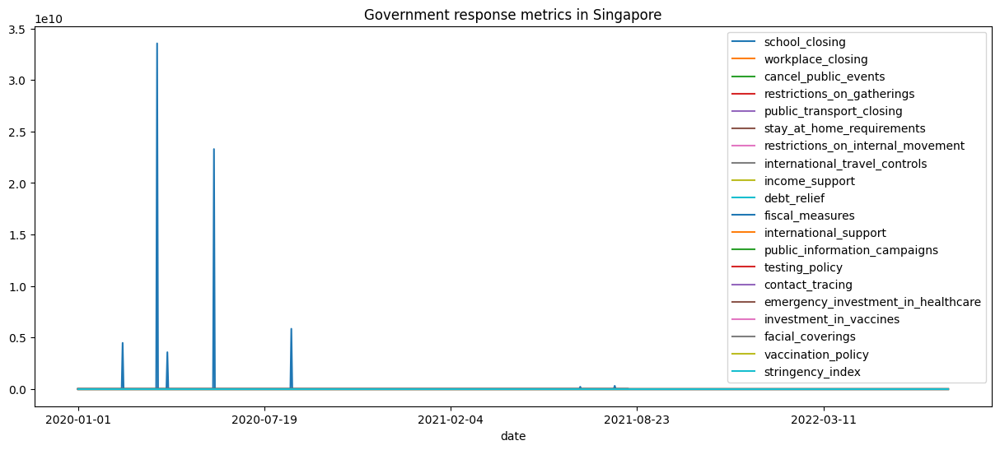

In [12]:
df_gvt_resp.loc[df_gvt_resp["country_name"] == "Singapore"].plot(x = "date", figsize=(15,6), title = "Government response metrics in Singapore")

<AxesSubplot:title={'center':'COVID Measures in Singapore'}, xlabel='date'>

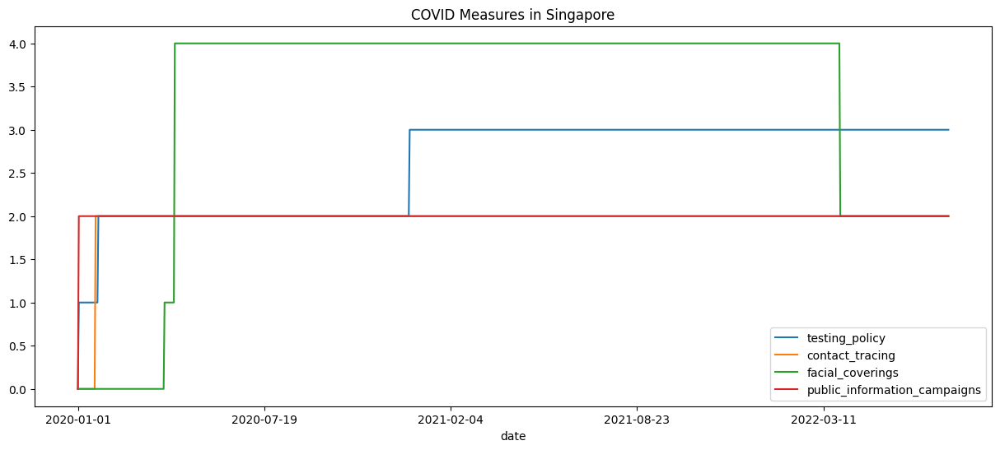

In [13]:
df_gvt_resp[["date", "testing_policy", "contact_tracing", "facial_coverings", "public_information_campaigns"]].loc[df_gvt_resp["country_name"] == "Singapore"].plot(x = "date", figsize=(15,6), title = "COVID Measures in Singapore")

<AxesSubplot:title={'center':'Movement restriction metrics in Singapore'}, xlabel='date'>

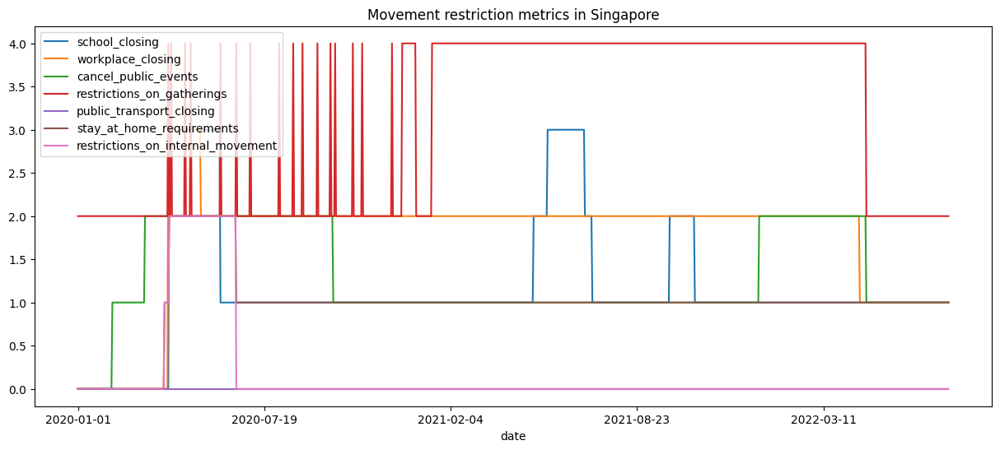

In [14]:
df_gvt_resp[["date", "school_closing", "workplace_closing", "cancel_public_events", "restrictions_on_gatherings", "public_transport_closing", "stay_at_home_requirements", "restrictions_on_internal_movement"]].loc[df_gvt_resp["country_name"] == "Singapore"].plot(x = "date", figsize=(15,6), title = "Movement restriction metrics in Singapore")

<AxesSubplot:title={'center':'Stringency index in Singapore'}, xlabel='date'>

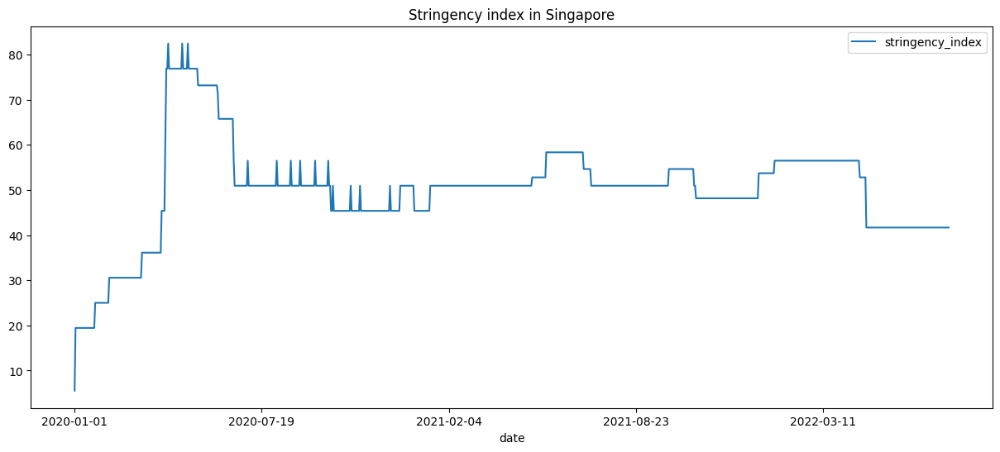

In [15]:
df_gvt_resp[["date", "stringency_index"]].loc[df_gvt_resp["country_name"] == "Singapore"].plot(x = "date", figsize=(15,6), title = "Stringency index in Singapore")

### There are only 3 countries represented for search trends vaccination
Canada, UK, and US

In [16]:
### Compare stringency index vs search vacc
df_search_vacc["country_name"].unique()

array(['Canada', 'United Kingdom', 'United States of America'],
      dtype=object)

### Canada stringency index vs search vacc

<AxesSubplot:title={'center':'Canada - Stringency index vs vaccination intent search trends'}, xlabel='date'>

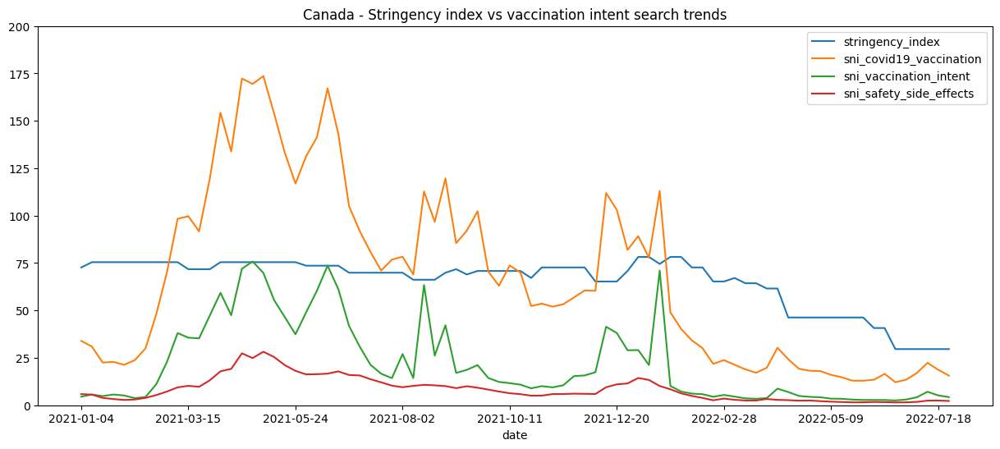

In [17]:
df_gvt_resp[["stringency_index", "date", "location_key"]].loc[df_gvt_resp["location_key"] == "CA"].merge(df_search_vacc.loc[df_search_vacc["key"] == "CA"], on = "date").plot(x= "date", figsize=(15, 6), title = "Canada - Stringency index vs vaccination intent search trends", ylim = (0, 200))

### US stringency index vs vacc search trends

<AxesSubplot:title={'center':'US - Stringency index vs vaccination intent search trends'}, xlabel='date'>

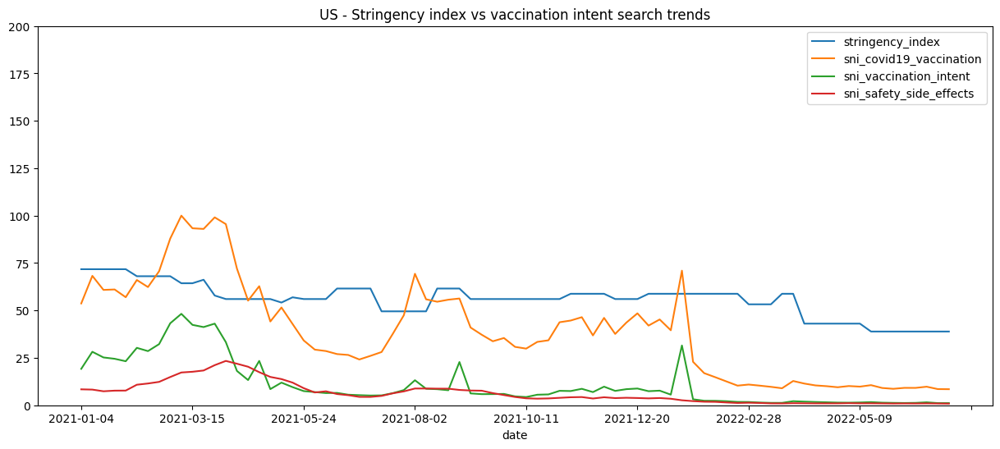

In [18]:
df_gvt_resp[["stringency_index", "date", "location_key"]].loc[df_gvt_resp["location_key"] == "US"].merge(df_search_vacc.loc[df_search_vacc["key"] == "US"], on = "date").plot(x= "date", figsize=(15, 6), title = "US - Stringency index vs vaccination intent search trends", ylim = (0, 200))

### UK stringency index vs vacc search trends

<AxesSubplot:title={'center':'UK - Stringency index vs vaccination intent search trends'}, xlabel='date'>

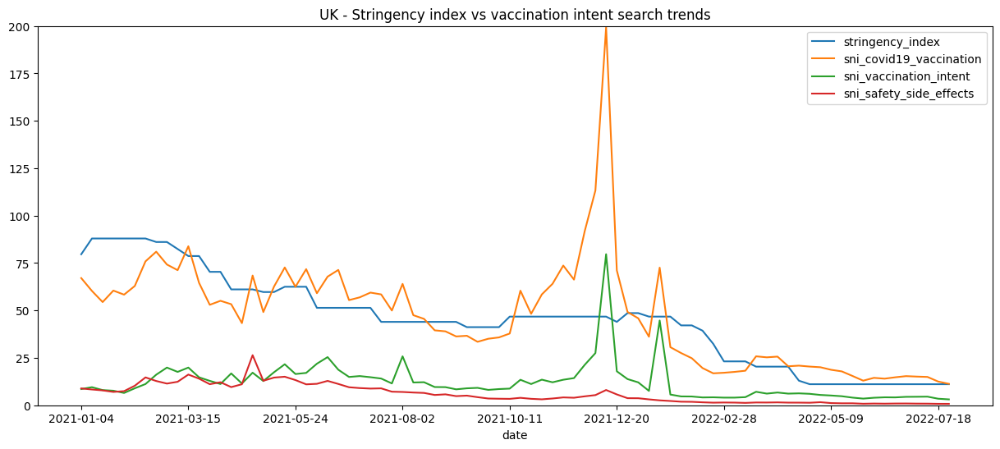

In [19]:
df_gvt_resp[["stringency_index", "date", "location_key"]].loc[df_gvt_resp["location_key"] == "GB"].merge(df_search_vacc.loc[df_search_vacc["key"] == "GB"], on = "date").plot(x= "date", figsize=(15, 6), title = "UK - Stringency index vs vaccination intent search trends", ylim = (0, 200))

### Cloropleth US map of stringency index over time across the different states

In [21]:
df_us_stringency = df_gvt_resp[["date", "stringency_index", "location_key"]].loc[df_gvt_resp["country_name"] == "United States of America"]

In [22]:
df_us_stringency.head()

,date,stringency_index,location_key
245543,2020-01-01,0.0,US
245544,2020-01-02,0.0,US
245545,2020-01-03,0.0,US
245546,2020-01-04,0.0,US
245547,2020-01-05,0.0,US


In [25]:
df_us_stringency["location_key"].unique()

array(['US', 'US_AK', 'US_AL', 'US_AR', 'US_AZ', 'US_CA', 'US_CO',
       'US_CT', 'US_DC', 'US_DE', 'US_FL', 'US_GA', 'US_HI', 'US_IA',
       'US_ID', 'US_IL', 'US_IN', 'US_KS', 'US_KY', 'US_LA', 'US_MA',
       'US_MD', 'US_ME', 'US_MI', 'US_MN', 'US_MO', 'US_MS', 'US_MT',
       'US_NC', 'US_ND', 'US_NE', 'US_NH', 'US_NJ', 'US_NM', 'US_NV',
       'US_NY', 'US_OH', 'US_OK', 'US_OR', 'US_PA', 'US_RI', 'US_SC',
       'US_SD', 'US_TN', 'US_TX', 'US_UT', 'US_VA', 'US_VT', 'US_WA',
       'US_WI', 'US_WV', 'US_WY'], dtype=object)

In [22]:
def split_state_code(location_code) :
    if location_code != "US" :
        state_code = location_code.split("US_")[1]

    else : 
        state_code = None
    
    return state_code

In [23]:
# Split US state name from the location_key
df_us_stringency["state_code"] = df_us_stringency["location_key"].apply(lambda x: split_state_code(x))

In [37]:
df_us_stringency.head()

,date,stringency_index,location_key,state_code
245543,2020-01-01,0.0,US,None
245544,2020-01-02,0.0,US,None
245545,2020-01-03,0.0,US,None
245546,2020-01-04,0.0,US,None
245547,2020-01-05,0.0,US,None


In [24]:
fig = px.choropleth(df_us_stringency.loc[df_us_stringency["state_code"] != None],
                    locations='state_code', 
                    locationmode="USA-states", 
                    color='stringency_index',
                    color_continuous_scale="Viridis_r", 
                    scope="usa",
                    animation_frame='date', 
                    title = "Change in US states' stringency index over time") #make sure 'period_begin' is string type and sorted in ascending order

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),
                  width=1500, 
                  height=800)

fig.show()

### Choropleth map of world stringency index

In [19]:
fig = px.choropleth(df_gvt_resp[["date", "stringency_index", "country_name"]],
                    locations='country_name', 
                    locationmode="country names", 
                    color='stringency_index',
                    color_continuous_scale="Viridis_r", 
                    scope="world",
                    animation_frame='date', 
                    title = "Change in countries' stringency index over time") #make sure 'period_begin' is string type and sorted in ascending order

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),
                  width=1500, 
                  height=800)

fig.show()

### Chloropleth map for US vaccination search trends

In [46]:
df_search_vacc.head()

,date,key,sni_covid19_vaccination,sni_vaccination_intent,sni_safety_side_effects,location_key,country_name
0,2021-01-04,CA,33.963,4.520,5.881,CA,Canada
1,2021-01-04,CA_AB,31.736,3.774,5.825,CA_AB,Canada
2,2021-01-04,CA_BC,35.991,4.243,6.136,CA_BC,Canada
3,2021-01-04,CA_MB,35.921,6.236,6.335,CA_MB,Canada
4,2021-01-04,CA_NB,27.852,2.853,4.950,CA_NB,Canada


In [25]:
df_search_vacc_us = df_search_vacc.loc[df_search_vacc["country_name"] == "United States of America"]
df_search_vacc_us["state_code"] = df_search_vacc_us["location_key"].apply(lambda x: split_state_code(x))
df_search_vacc_us.head()

c:\Users\Tristan\Desktop\Assignments\P4DS\p4ds_env\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,key,sni_covid19_vaccination,sni_vaccination_intent,sni_safety_side_effects,location_key,country_name,state_code
122,2021-01-04,US,53.694,19.203,8.406,US,United States of America,None
123,2021-01-04,US_AK,83.722,30.907,18.440,US_AK,United States of America,AK
124,2021-01-04,US_AK_02050,81.662,NaN,23.109,US_AK_02050,United States of America,AK_02050
125,2021-01-04,US_AK_02090,61.752,21.825,13.181,US_AK_02090,United States of America,AK_02090
126,2021-01-04,US_AK_02122,81.088,30.599,17.275,US_AK_02122,United States of America,AK_02122


In [26]:
fig = px.choropleth(df_search_vacc_us.loc[df_search_vacc_us["state_code"] != None],
                    locations='state_code', 
                    locationmode="USA-states", 
                    color='sni_covid19_vaccination',
                    color_continuous_scale="Viridis_r", 
                    scope="usa",
                    animation_frame='date', 
                    title = "Change in search trends related to COVID_19 vaccination topics over time") #make sure 'period_begin' is string type and sorted in ascending order

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),
                  width=1500, 
                  height=800)

fig.show()

In [15]:
### Plot of stringency index vs covid vacc search, clustered by country
df_plot = df_gvt_resp[["date", "stringency_index", "location_key"]].loc[ (df_gvt_resp["country_name"] == "United States of America") | (df_gvt_resp["country_name"] == "United Kingdom") | (df_gvt_resp["country_name"] == "Canada")]
df_plot = pd.merge(df_plot, df_search_vacc[["key", "sni_covid19_vaccination", "sni_vaccination_intent", "sni_safety_side_effects"]], left_on="location_key", right_on="key")

df_plot["location_key"].unique()

array(['CA', 'CA_AB', 'CA_BC', 'CA_MB', 'CA_NB', 'CA_NL', 'CA_NS',
       'CA_NT', 'CA_NU', 'CA_ON', 'CA_PE', 'CA_QC', 'CA_SK', 'CA_YT',
       'GB', 'GB_ENG', 'GB_NIR', 'GB_SCT', 'GB_WLS', 'US', 'US_AK',
       'US_AL', 'US_AR', 'US_AZ', 'US_CA', 'US_CO', 'US_CT', 'US_DE',
       'US_FL', 'US_GA', 'US_HI', 'US_IA', 'US_ID', 'US_IL', 'US_IN',
       'US_KS', 'US_KY', 'US_LA', 'US_MA', 'US_MD', 'US_ME', 'US_MI',
       'US_MN', 'US_MO', 'US_MS', 'US_MT', 'US_NC', 'US_ND', 'US_NE',
       'US_NH', 'US_NJ', 'US_NM', 'US_NV', 'US_NY', 'US_OH', 'US_OK',
       'US_OR', 'US_PA', 'US_RI', 'US_SC', 'US_SD', 'US_TN', 'US_TX',
       'US_UT', 'US_VA', 'US_VT', 'US_WA', 'US_WI', 'US_WV', 'US_WY'],
      dtype=object)

#### US emergency declarations (df_emergency)

In [6]:
# Date range seems limited from jan 2020 to july 2020
df_emergency["date"].unique()

array(['2020-01-20', '2020-01-21', '2020-01-22', '2020-01-23',
       '2020-01-24', '2020-01-25', '2020-01-26', '2020-01-27',
       '2020-01-28', '2020-01-29', '2020-01-30', '2020-01-31',
       '2020-02-01', '2020-02-02', '2020-02-03', '2020-02-04',
       '2020-02-05', '2020-02-06', '2020-02-07', '2020-02-08',
       '2020-02-09', '2020-02-10', '2020-02-11', '2020-02-12',
       '2020-02-13', '2020-02-14', '2020-02-15', '2020-02-16',
       '2020-02-17', '2020-02-18', '2020-02-19', '2020-02-20',
       '2020-02-21', '2020-02-22', '2020-02-23', '2020-02-24',
       '2020-02-25', '2020-02-26', '2020-02-27', '2020-02-28',
       '2020-02-29', '2020-03-01', '2020-03-02', '2020-03-03',
       '2020-03-04', '2020-03-05', '2020-03-06', '2020-03-07',
       '2020-03-08', '2020-03-09', '2020-03-10', '2020-03-11',
       '2020-03-12', '2020-03-13', '2020-03-14', '2020-03-15',
       '2020-03-16', '2020-03-17', '2020-03-18', '2020-03-19',
       '2020-03-20', '2020-03-21', '2020-03-22', '2020-

In [7]:
df_emergency.columns

Index(['date', 'location_key', 'lawatlas_mitigation_policy',
       'lawatlas_state_emergency', 'lawatlas_emerg_statewide',
       'lawatlas_travel_requirement',
       'lawatlas_traveler_type_all_people_entering_the_state',
       'lawatlas_traveler_type_travelers_from_specified_states',
       'lawatlas_traveler_type_travelers_from_specified_countries',
       'lawatlas_traveler_type_general_international_travelers',
       ...
       'lawatlas_action_preempt_imposing_additional_restrictions_on_public_spaces',
       'lawatlas_action_preempt_restricting_scope_of_services_of_an_essential_business',
       'lawatlas_action_preempt_expanding_the_definition_of_non-essential_business',
       'lawatlas_action_preempt_restricting_the_hours_of_operation_of_an_essential_business',
       'lawatlas_action_preempt_imposing_restrictions_that_conflict_with_state_order',
       'lawatlas_action_preempt_restricting_the_performance_of_an_essential_function',
       'lawatlas_action_preempt_restrict

### Probably need to do feature selection to choose which features are the most important
Dependent variables: 104 cols, Independent variable: Stringency index from the df_gvt_resp dataset?

https://towardsdatascience.com/5-feature-selection-method-from-scikit-learn-you-should-know-ed4d116e4172

## Search trends symptoms vs government response

In [8]:
df_search = dd.read_csv(DATA_PATH+"google-search-trends.csv")

## Join country_name from index to search trends
df_search = dd.merge(df_search, df_index[["location_key", "country_name"]], on = "location_key", how = "left")
df_search_col_names = df_search.columns

#### We want to limit to the symptoms of covid 19: make it easier to conduct analysis

https://www.cdc.gov/coronavirus/2019-ncov/symptoms-testing/symptoms.html

- Fever or chills
- Cough
- Shortness of breath or difficulty breathing
- Fatigue
- Muscle or body aches
- Headache
- New loss of taste or smell
- Sore throat
- Congestion or runny nose
- Nausea or vomiting
- Diarrhea

According to EDA done on the symptoms, fever, cough, sore thorat seem to be indicative of searches done directly because of COVID (since these were the symptoms that spiked together)

In [2]:
ls_covid_symptoms = ['search_trends_fever', 'search_trends_low_grade_fever', 'search_trends_chills', 'search_trends_cough', 'search_trends_shallow_breathing', 'search_trends_shortness_of_breath', 'search_trends_fatigue', 'search_trends_delayed_onset_muscle_soreness', 'search_trends_muscle_weakness', 'search_trends_cluster_headache', 'search_trends_headache', 'search_trends_sore_throat', 'search_trends_nasal_congestion', 'search_trends_nausea', 'search_trends_vomiting', 'search_trends_diarrhea']

In [10]:
df_search = df_search[ls_covid_symptoms+["date", "location_key", "country_name"]]

df_search.head()

,search_trends_fever,search_trends_low_grade_fever,search_trends_chills,search_trends_cough,search_trends_shallow_breathing,search_trends_shortness_of_breath,search_trends_fatigue,search_trends_delayed_onset_muscle_soreness,search_trends_muscle_weakness,search_trends_cluster_headache,search_trends_headache,search_trends_sore_throat,search_trends_nasal_congestion,search_trends_nausea,search_trends_vomiting,search_trends_diarrhea,date,location_key,country_name
0,3.89,0.07,0.23,5.70,0.08,0.76,8.13,0.63,0.22,0.18,4.14,2.40,1.51,2.78,4.23,5.42,2020-01-01,AU,Australia
1,4.02,0.08,0.24,5.79,0.06,0.75,10.05,0.67,0.21,0.18,4.04,2.39,1.50,2.70,3.97,5.25,2020-01-02,AU,Australia
2,4.33,0.06,0.24,5.71,0.06,0.69,12.11,0.72,0.20,0.16,4.06,2.69,1.47,2.64,3.90,5.18,2020-01-03,AU,Australia
3,3.91,0.07,0.23,5.56,0.06,0.70,8.46,0.73,0.20,0.18,4.12,2.33,1.51,2.58,3.88,5.07,2020-01-04,AU,Australia
4,3.92,0.08,0.26,5.90,0.07,0.83,7.85,0.65,0.24,0.19,4.05,2.25,1.43,2.65,3.73,4.91,2020-01-05,AU,Australia


In [11]:
df_search_stringency = dd.merge(df_search, df_gvt_resp[["date","stringency_index", "location_key"]], on =["location_key", "date"])

df_search_stringency.head()

,search_trends_fever,search_trends_low_grade_fever,search_trends_chills,search_trends_cough,search_trends_shallow_breathing,search_trends_shortness_of_breath,search_trends_fatigue,search_trends_delayed_onset_muscle_soreness,search_trends_muscle_weakness,search_trends_cluster_headache,search_trends_headache,search_trends_sore_throat,search_trends_nasal_congestion,search_trends_nausea,search_trends_vomiting,search_trends_diarrhea,date,location_key,country_name,stringency_index
0,3.89,0.07,0.23,5.70,0.08,0.76,8.13,0.63,0.22,0.18,4.14,2.40,1.51,2.78,4.23,5.42,2020-01-01,AU,Australia,0.0
1,4.02,0.08,0.24,5.79,0.06,0.75,10.05,0.67,0.21,0.18,4.04,2.39,1.50,2.70,3.97,5.25,2020-01-02,AU,Australia,0.0
2,4.33,0.06,0.24,5.71,0.06,0.69,12.11,0.72,0.20,0.16,4.06,2.69,1.47,2.64,3.90,5.18,2020-01-03,AU,Australia,0.0
3,3.91,0.07,0.23,5.56,0.06,0.70,8.46,0.73,0.20,0.18,4.12,2.33,1.51,2.58,3.88,5.07,2020-01-04,AU,Australia,0.0
4,3.92,0.08,0.26,5.90,0.07,0.83,7.85,0.65,0.24,0.19,4.05,2.25,1.43,2.65,3.73,4.91,2020-01-05,AU,Australia,0.0


In [16]:
# Which countries have search trends: Probably only english speaking ones
countries_search_trends = df_search_stringency["location_key"].unique().compute()

0         AU
1     AU_ACT
2     AU_NSW
3      AU_NT
4     AU_QLD
       ...  
60     US_VT
61     US_WA
62     US_WI
63     US_WV
64     US_WY
Name: location_key, Length: 65, dtype: object


In [17]:
print(list(countries_search_trends))

['AU', 'AU_ACT', 'AU_NSW', 'AU_NT', 'AU_QLD', 'AU_SA', 'AU_TAS', 'AU_VIC', 'AU_WA', 'GB', 'IE', 'NZ', 'SG', 'US', 'US_AK', 'US_AL', 'US_AR', 'US_AZ', 'US_CA', 'US_CO', 'US_CT', 'US_DC', 'US_DE', 'US_FL', 'US_GA', 'US_HI', 'US_IA', 'US_ID', 'US_IL', 'US_IN', 'US_KS', 'US_KY', 'US_LA', 'US_MA', 'US_MD', 'US_ME', 'US_MI', 'US_MN', 'US_MO', 'US_MS', 'US_MT', 'US_NC', 'US_ND', 'US_NE', 'US_NH', 'US_NJ', 'US_NM', 'US_NV', 'US_NY', 'US_OH', 'US_OK', 'US_OR', 'US_PA', 'US_RI', 'US_SC', 'US_SD', 'US_TN', 'US_TX', 'US_UT', 'US_VA', 'US_VT', 'US_WA', 'US_WI', 'US_WV', 'US_WY']


### Plots of stringency vs search trends over time for different countries

Note that the absolute values are not comparable between countries since these metrics are relative to within each country only.

<AxesSubplot:xlabel='date'>

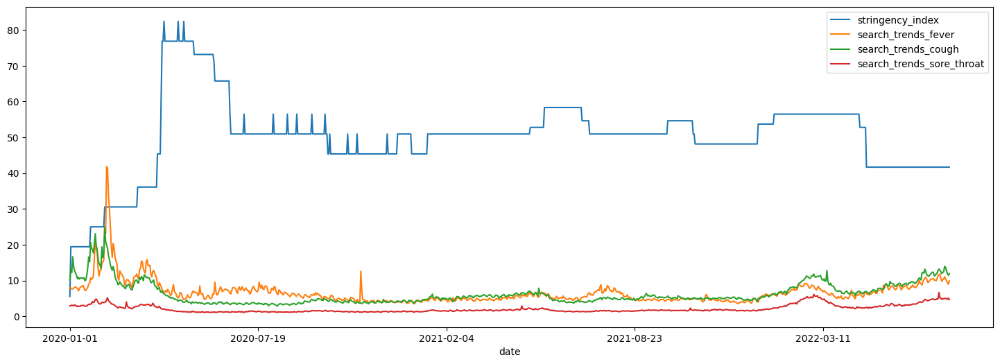

In [28]:
df_temp_SG = df_search_stringency.loc[df_search_stringency["location_key"] == "SG"].compute()
df_temp_SG[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))

<AxesSubplot:xlabel='date'>

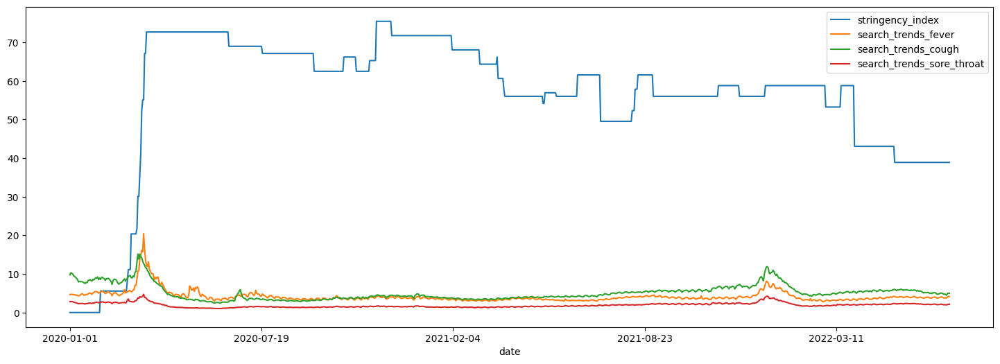

In [29]:
df_temp_US = df_search_stringency.loc[df_search_stringency["location_key"] == "US"].compute()
df_temp_US[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))

<AxesSubplot:xlabel='date'>

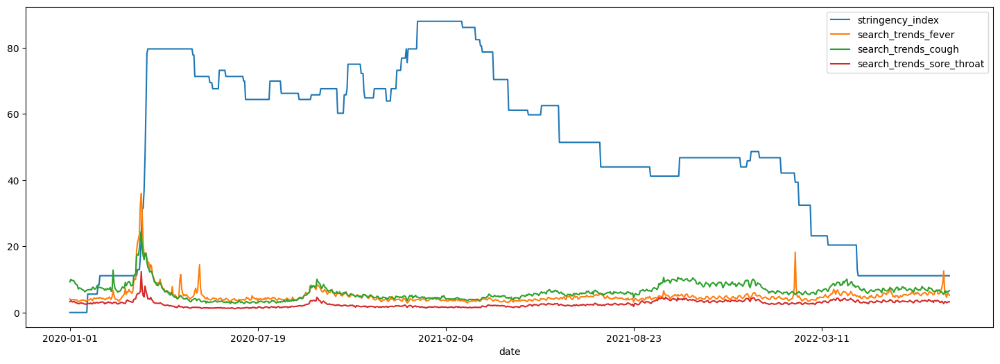

In [31]:
df_temp_uk = df_search_stringency.loc[df_search_stringency["location_key"] == "GB"].compute()
df_temp_uk[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))

<AxesSubplot:xlabel='date'>

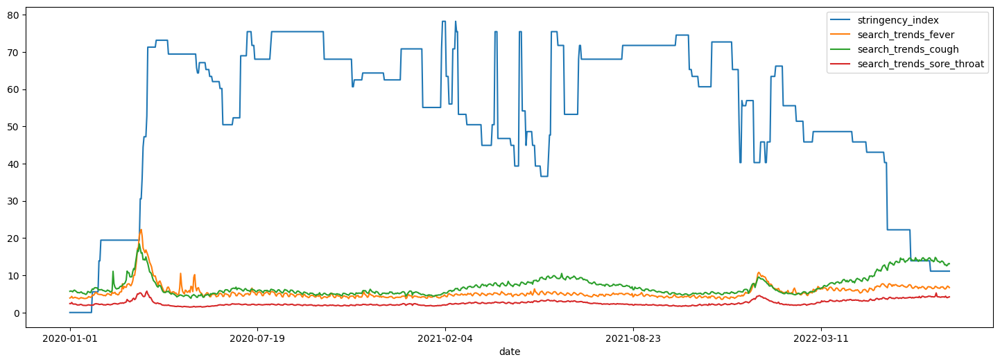

In [12]:
df_temp_au = df_search_stringency.loc[df_search_stringency["location_key"] == "AU"].compute()
df_temp_au[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))

<AxesSubplot:xlabel='date'>

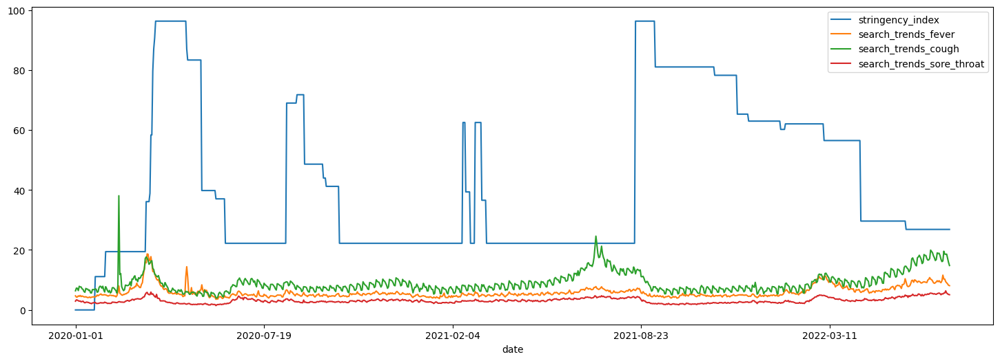

In [15]:
df_temp_nz = df_search_stringency.loc[df_search_stringency["location_key"] == "NZ"].compute()
df_temp_nz[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))

<AxesSubplot:xlabel='date'>

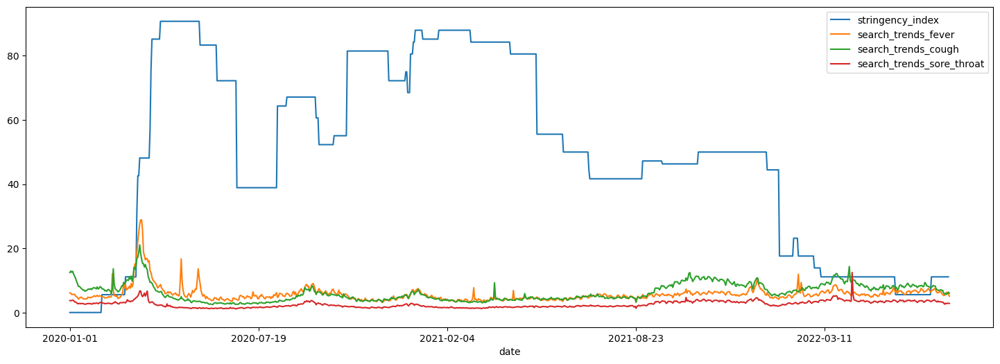

In [18]:
df_temp_ie = df_search_stringency.loc[df_search_stringency["location_key"] == "IE"].compute()
df_temp_ie[["date", "stringency_index", "search_trends_fever", "search_trends_cough", "search_trends_sore_throat"]].plot(x = "date", figsize = (18, 6))